Импортируем библиотеки

In [53]:
import pandas as pd
import os
import cv2
import numpy as np
from PIL import Image, ImageEnhance, ImageEnhance, ImageGrab, ImageOps
import matplotlib.pyplot as plt
import tifffile
from dataclasses import dataclass
from sklearn.neighbors import NearestNeighbors

### Загружаем изображения

In [54]:
base_path = 'C:/Users/Maria Smirnova/Desktop/Проекты/LDT/scenes'
mask_key_word = 'layout'
files_format = ['tif']

images = [] 
masks = []
for address, dirs, files in os.walk(base_path):
    #print(address, dirs, files)
    for f in files:
            if f.endswith('tif'):
                file_path = os.path.join(address, f)
                if (mask_key_word in f):
                    if f  == 'layout_2021-08-16.tif':
                        #masks.append(Image.open(file_path))
                        mask = tifffile.imread(file_path)
                        masks.append(mask)
                else:
                    #images.append(Image.open(file_path))
                    #images.append(Scene(tifffile.imread(file_path), 0))
                    images.append(tifffile.imread(file_path))

print('Количество изображений:', len(images), '\nКоличество масок:', len(masks))

Количество изображений: 20 
Количество масок: 1


## Функции

In [55]:
def row_img_to_layers(img):
    norm_coef = 90
    r = normalize_channel(img[:,:,0], norm_coef)
    g = normalize_channel(img[:,:,1], norm_coef)
    b = normalize_channel(img[:,:,2], norm_coef)
    nir = normalize_channel(img[:,:,3], norm_coef)
    return r, g, b, nir

def hist_equalization(channel:np.array) -> np.array:
    if len(channel.shape) > 2:
        print(channel.shape[len(channel.shape)-1])
        channel = cv2.cvtColor(channel, cv2.COLOR_BGR2GRAY)
    channel = cv2.equalizeHist(channel)
    return channel

def normalize_channel(channel: np.array, perc_thr: int = 100, lower_pecr_thr: int = 2) -> np.array:
    '''
    Get's (h, w, 1) - channel-layer, pecentage to cut histogram
    return normalize and cut data
    '''
    perc_rows = np.percentile(channel, perc_thr, axis=1)
    perc_cols = np.percentile(channel, perc_thr, axis=0)
    thr = max(np.max(perc_rows), np.max(perc_cols))

    lower_pecr_thr = 2
    perc_rows = np.percentile(channel, lower_pecr_thr, axis=1)
    perc_cols = np.percentile(channel, lower_pecr_thr, axis=0)
    thr_min = min(np.min(perc_rows), np.min(perc_cols))

    channel[channel > thr] = thr
    #l[l > thr] = np.mean(l)
    channel[channel < thr_min] = thr_min
    if np.max(channel) !=0:
        channel = channel/np.max(channel)
    channel = channel*255 # приводим к 0 255
    channel = channel.astype(np.uint8)
    return channel

def normalize(image: np.array, perc_thr: int = 100, lower_pecr_thr: int = 2) -> np.array:
    '''
    Get's (h, w, 1) - image, pecentage to cut histogram
    return normalize image
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0], perc_thr, lower_pecr_thr)
    g = normalize_channel(image[:, :, 1], perc_thr, lower_pecr_thr)
    b = normalize_channel(image[:, :, 2], perc_thr, lower_pecr_thr)
    nir = normalize_channel(image[:, :, 3], perc_thr, lower_pecr_thr)
    if channel == 0:
        r = normalize_channel(image[0, :, :], perc_thr, lower_pecr_thr)
        g = normalize_channel(image[1 :, :], perc_thr, lower_pecr_thr)
        b = normalize_channel(image[2, :, :], perc_thr, lower_pecr_thr)
        nir = normalize_channel(image[3, :, :], perc_thr, lower_pecr_thr)
    image = np.dstack((r, g, b, nir))
    return image

def imshow(image: np.array, bands: str, hist_equal: bool = False) -> None:
    '''
    Function get images as np.array 
    and bands neeeded to show (1 to 3), expl: r, nir, d
    and print it
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0])
    g = normalize_channel(image[:, :, 1])
    b = normalize_channel(image[:, :, 2])
    nir = normalize_channel(image[:, :, 3])
    if channel == 0:
        r = normalize_channel(image[0, :, :])
        g = normalize_channel(image[1 :, :])
        b = normalize_channel(image[2, :, :])
        nir = normalize_channel(image[3, :, :])
            
    chn_dict = {'r':r, 'g':g, 'b':b, 'nir':nir}

    if hist_equal:
        for key in list(chn_dict.keys()):
            chn_dict[key] = hist_equalization(chn_dict[key])

    b_list = []
    for b in bands.split(', '):
        b_list.append(chn_dict[b])
    
    img = np.dstack(b_list)
    plt.imshow(img)
    plt.show()

def normalized_filtered(image: np.array, bands: str, hist_equal: bool = False) -> np.array:
    '''
    The same as imshow(), but return np.array
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0])
    g = normalize_channel(image[:, :, 1])
    b = normalize_channel(image[:, :, 2])
    nir = normalize_channel(image[:, :, 3])
    if channel == 0:
        r = normalize_channel(image[0, :, :])
        g = normalize_channel(image[1 :, :])
        b = normalize_channel(image[2, :, :])
        nir = normalize_channel(image[3, :, :])
            
    chn_dict = {'r':r, 'g':g, 'b':b, 'nir':nir}

    if hist_equal:
        for key in list(chn_dict.keys()):
            chn_dict[key] = hist_equalization(chn_dict[key])

    b_list = []
    for b in bands.split(', '):
        b_list.append(chn_dict[b])
    
    img = np.dstack(b_list)
    return img


In [56]:
# показывает растительность
def calcus_NDVI(r:np.array, nir:np.array, masking:bool = False) -> np.array:
    NDVI = (nir - r)/(nir +r)
    NDVI[NDVI>1] = 1
    NDVI[NDVI<-1] = -1
    if masking:
        NDVI[NDVI>=0.7] = 4
        NDVI[(NDVI>=0.4)&(NDVI<0.7)] = 3
        NDVI[(NDVI>=0)&(NDVI<0.4)] = 2
        NDVI[(NDVI>=-1)&(NDVI<0)] = 1
    return NDVI

# оптимизированный NDVI, учитывает атмосферные воздыейтсви и фоновый сигнал раст., не становится оч насыщенным
def calcus_EVI(r, b, nir, masking:bool = False):
    EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
    EVI[EVI>10] = 10
    EVI[EVI<-5] = -5
    if masking:
        EVI[EVI<-2.1] = -100
        EVI[(EVI>=-2.1)&(EVI<0)] = -200 
        EVI[(EVI>=0)&(EVI<8)] = -300
        EVI[EVI>=8] = -400
        EVI = EVI/(-100) 
    return EVI

# индекс фотосинтетической активности растительного покрова
def calcus_GNDVI(g, nir, masking=False):
    GNDVI = (nir-g)/(nir+g)
    GNDVI[GNDVI>1] = 1
    GNDVI[GNDVI<-1] = -1
    if masking:
        GNDVI[GNDVI<0.35] = 100
        GNDVI[(GNDVI>=0.35) & (GNDVI<0.57)] = 200
        GNDVI[(GNDVI>=0.57) & (GNDVI<=1)] = 300
        GNDVI = GNDVI/100
    return GNDVI

# концентрация хлорофила, оч. зависит от времени года
def calcus_MCARI(r,g,nir):
    MCARI = (1.5*(2.5*(nir - r) - 1.3*(nir - g)))/np.sqrt((2*nir + 1)**2 - (6*nir - 5*np.sqrt(r))) - 5
    MCARI[MCARI>10] = np.nan
    MCARI[MCARI<-4] = np.nan
    return MCARI

# индекс мутности воды, слабо резает
def calcus_NDTI(r,g, masking=False):
    NDTI = (r-g)/(r+g)
    if masking:
        NDTI[NDTI<60] = 1
        NDTI[(NDTI>=60)&(NDTI<80)] = 2
        NDTI[NDTI>=80] = 3
    return NDTI

#ration vegetation index 
def calcus_RVI(r, nir, masking=False):
    if r.any() == 0:
        r = 1
    RVI = nir/r
    if masking:
        RVI[RVI<2.5] = 1
        RVI[(RVI>=2.5)&(RVI<4.0)] = 2
        RVI[(RVI>4.0)&(RVI<10)] = 3
        RVI[RVI>=10] = 4
    return RVI

# Kauth-Thomas transformation Tasseled Cap
# Используем ИК без разделения, в оригнале ИК делится по волнам: 07,-08/ 0,8-1,1
def calcus_tasseled_cap(r,g, nir, masking=False):
    # яркость, связана с измненеиями в почве
    b = 0.433*g + 0.632*r + 0.586*nir + 0.264*nir +32
    # зелёность, связана с зелёной растительность, похожа на вегетационный индекс
    g = -0.290*g-0.562*r+0.600*nir+0.491*nir +32
    # желтость, старением растений
    y = -0.829*g +0.522*r-0.039*nir +0.197*nir +32
    # nonesuch
    n = 0.233*g+0.012*r-0.543*nir +0.810*nir +32
    tass_cap = np.dstack((b, g, y, n))
    if masking:
        tass_cap[tass_cap<-2000] = -10000
        tass_cap[(tass_cap>=-2000)&(tass_cap<0)] = -20000
        tass_cap[(tass_cap>=0)&(tass_cap<1800)] = -30000
        tass_cap[(tass_cap>=1800)&(tass_cap<3700)] = -40000
        tass_cap[tass_cap>=3500] = -50000
        tass_cap = tass_cap/(-10000)
    return tass_cap



#normalized diffference snow index
# НЕ ИСПОЛЬЗУЕМ 
#вместо коротковолнового ИК, просто ИК
def calcus_NDSI(g, nir):
    NDSI = (g-nir)/(g+nir)
    return NDSI

#normalized defference water index
def calcus_NDWI(g, nir, masking=False):
    NDWI = (g-nir)/(g+nir)
    if masking:
        NDWI[NDWI<26] = 1
        NDWI[(NDWI>=26)&(NDWI<42)] = 2
        NDWI[(NDWI>=42)] = 3
    return NDWI

In [57]:
def get_mean_neighbours(image, channel: int, x: int, y: int) -> int:
        neighbours = []
        rows, cols = image.shape[:-1]

        # Список смещений для всех возможных соседей
        offsets = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        for dy, dx in offsets:
            ny, nx = y + dy, x + dx
            if 0 <= nx < cols and 0 <= ny < rows:
                neighbours.append(image[ny][nx][channel])
        return round(np.mean(neighbours))

def calculate_thresholds(image):
    # Преобразование изображения в одномерный массив
    flattened_image = image.flatten()

    median_value = np.median(flattened_image)
    # Вычисление пороговых значений
    low_threshold = 0.15 * median_value
    high_threshold = 5.0 * median_value

    return low_threshold, high_threshold    

def fix(image):
    raster = image.copy()
    y, x = image.shape[:-1]
    for channel in range(image.shape[-1]):
        min_pixel, max_pixel = calculate_thresholds(raster[:, :,channel])
        # print(f'low is {min_pixel}, max is {max_pixel}')
        for i in range(y):
            for j in range(x):
                if raster[i][j][channel] < min_pixel or raster[i][j][channel] > max_pixel:
                    new_pixel = get_mean_neighbours(raster, channel, y=i, x=j)
                    #  task:    [номер строки]; [номер столбца]; [номер канала]; [«битое» значение]; [исправленное значение]
                    #print(f"[{i}];[{j}];[{channel + 1}];[{raster[i][j][channel]}];[{new_pixel}]")
                    raster[i][j][channel] = new_pixel
    return raster

## Описываем класс

In [84]:
@dataclass
class Scene:
    row_img: np.array
    img: np.array
    is_mask: bool
    r: np.array
    g: np.array
    b: np.array
    nir: np.array
    NDVI: np.array
    EVI:np.array
    GNDVI:np.array
    #MCARI:np.array
    NDTI: np.array
    RVI: np.array
    tass_cap: np.array
    NDWI: np.array
    #all_layes: np.array

    def __init__(self, row_img: np.array, is_mask: bool):
        self.row_img = row_img
        self.img = row_img
        self.is_mask = is_mask
        self.r ,self.g, self.b, self.nir = row_img_to_layers(row_img)
        self.NDVI = calcus_NDVI(self.r,self.nir)
        self.EVI = calcus_EVI(self.r, self.b, self.nir)
        self.GNDVI = calcus_GNDVI(self.g, self.nir)
        #self.MCARI = calcus_MCARI(self.r, self.g, self.nir)
        self.NDTI = calcus_NDTI(self.r, self.g)
        self.RVI = calcus_RVI(self.r, self.nir)
        self.tass_cap = calcus_tasseled_cap(self.r, self.g, self.nir)
        self.NDWI = calcus_NDWI(self.g, self.nir)
        '''
        self.all_layers = np.dstack((self.r, self.g, self.b, self.nir,
                                    self.NDVI, self.EVI, self.GNDVI,
                                    self.NDTI, self.RVI, self.tass_cap,
                                    self.NDWI))
        '''

## Обработка битых пикселей

211


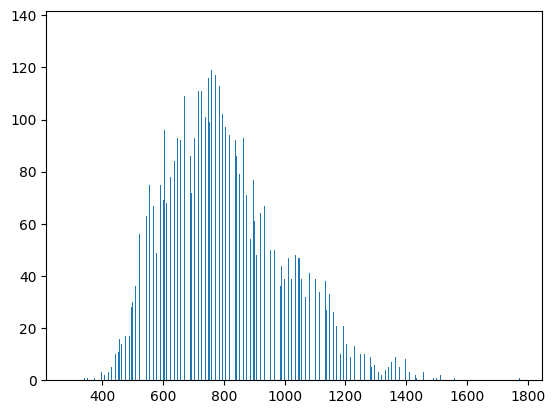

(array([1., 0., 1., ..., 0., 0., 1.]),
 array([ 139.    ,  140.1034,  141.2068, ..., 5653.7932, 5654.8966,
        5656.    ]),
 <BarContainer object of 5000 artists>)

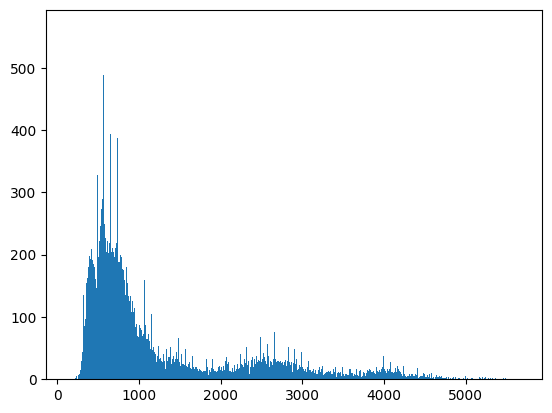

In [292]:
print(len(images[0][:,:, 0]))
plt.hist(images[0][:,:, 1].ravel(), bins=5000)
plt.show()
plt.hist(fix(images[0]).ravel(), bins=5000)

## Создаём объекты класса

In [59]:
scenes = []
for img in images:
    scenes.append(Scene(img, 0))

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:98

In [60]:
#back = (Scene(masks[0], 1))
masks[0][:1000, :1000, :]
small_back = Scene(masks[0][:7000, :7000, :], 1)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:15: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipyk

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Загрузка изображения
image = scenes[0]
image = normalized_filtered(image.img, ch_channels, True)

# Проверка, что изображение загружено
if image is None:
    raise ValueError(f"Изображение по пути {image_path} не найдено.")

# Применение оператора Канни для нахождения границ
edges = cv2.Canny(image, 100, 200)


# Создание маски для замены границ на NaN
mask = edges != 0
image_with_nan = image#.astype(float)
image_with_nan[mask] = 0

# Визуализация результатов
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.title('Оригинальное изображение')
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title('Границы Канни')
plt.imshow(edges, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Изображение с NaN вместо границ')
plt.imshow(image_with_nan)
plt.axis('off')

plt.tight_layout()
plt.show()

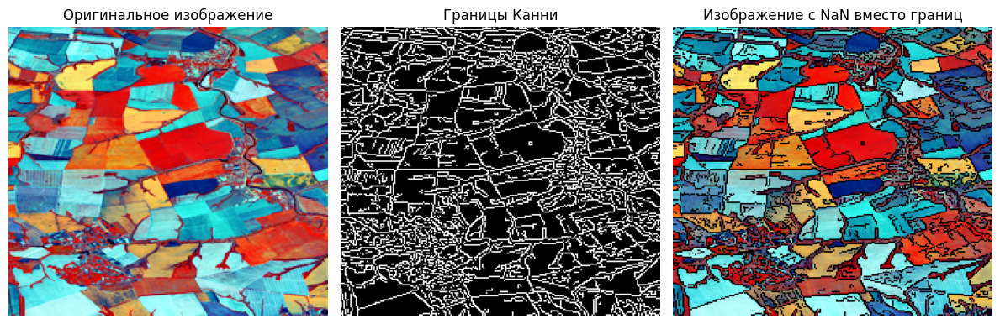

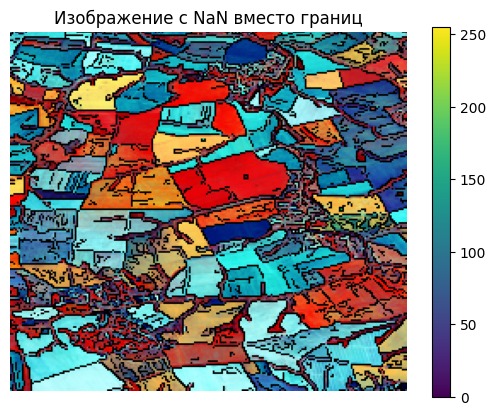

In [52]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Загрузка изображения
image = scenes[0]
image = normalized_filtered(image.img, ch_channels, True)

# Проверка, что изображение загружено
if image is None:
    raise ValueError(f"Изображение по пути {image_path} не найдено.")

# Применение оператора Канни для нахождения границ
edges = cv2.Canny(image, 100, 200)


# Создание маски для замены границ на NaN
mask = edges != 0
image_with_nan = image.astype(np.uint8)
image_with_nan[mask] = 0

# Визуализация результатов
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.title('Оригинальное изображение')
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title('Границы Канни')
plt.imshow(edges, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Изображение с NaN вместо границ')
plt.imshow(image_with_nan)
plt.axis('off')

plt.tight_layout()
plt.show()


plt.title('Изображение с NaN вместо границ')
plt.imshow(image_with_nan)
plt.axis('off')
plt.colorbar()

TypeError: Invalid shape (24077,) for image data

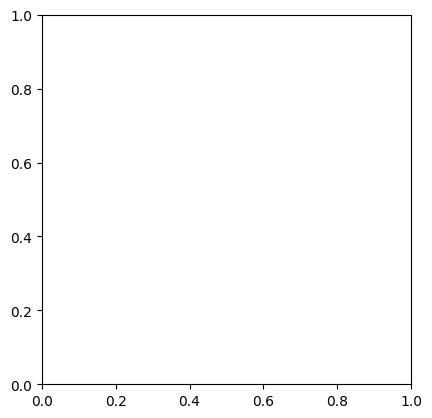

In [51]:
new_masked = image_with_nan.copy()
[(image_with_nan > 200) & (image_with_nan <250)]
plt.imshow(new_masked)

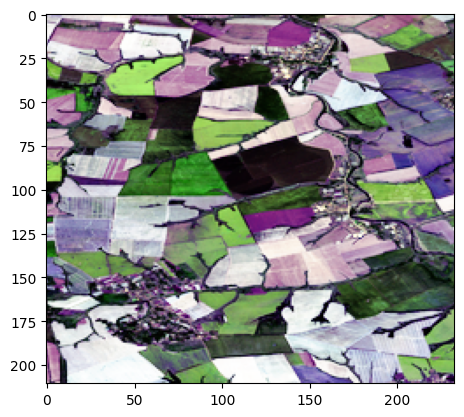

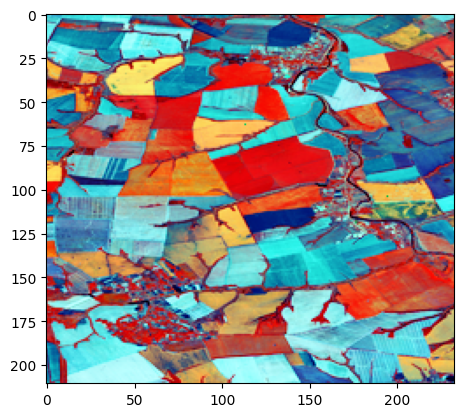

(211, 233, 3)


error: OpenCV(4.9.0) :-1: error: (-5:Bad argument) in function 'cvtColor'
> Overload resolution failed:
>  - src is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'src'


In [14]:
img = scenes[0]
ch_channels = 'nir, g, b'
imshow(img.img, 'r, g, b', True)
imshow(img.img, ch_channels, True)
img  = calcus_NDVI(img.r, img.nir)


#plt.imshow(calcus_NDVI(img.r, img.nir, True))
#plt.show()
im = normalized_filtered(img.img, ch_channels, True)#[:100, :100, :]
#im = calcus_NDVI(img.r, img.nir)
print(im.shape)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
edged = cv2.Canny(img, 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
im = calcus_NDVI(img.r, img.nir)
plt.imshow(cv2.drawContours(im, contours, -1, (255, 1, 1), 1))
contoured = cv2.drawContours(im, contours, -1, (255, 0, 1), 1)
plt.show()





kernel = np.array([[-1/9,-1/9,-1/9], [-1/9,17/9,-1/9], [-1/9,-1/9,-1/9]])
#Laplacian operator, sharpening filter L/
#kernel = np.array([[-0,-1/4,0], [-1/4, 2,-1/4], [0,-1/4,0]])
sharpened_image = cv2.filter2D(contoured, -1, kernel)
plt.imshow(sharpened_image)
plt.show()
#opening
#sharpened_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)

binr = cv2.threshold(sharpened_image, 0, 255, 
                     cv2.THRESH_BINARY)[1] 
  
# define the kernel 
kernel = np.ones((3, 3), np.uint8) 
  
# opening the image 
opening = cv2.morphologyEx(binr,  cv2.MORPH_OPEN, 
                           kernel, iterations=15) 
# print the output 
plt.imshow(opening, cmap='gray') 

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:98

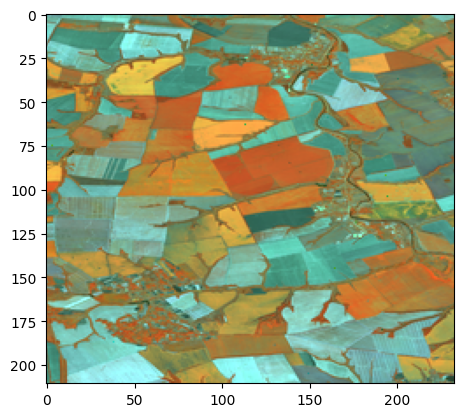

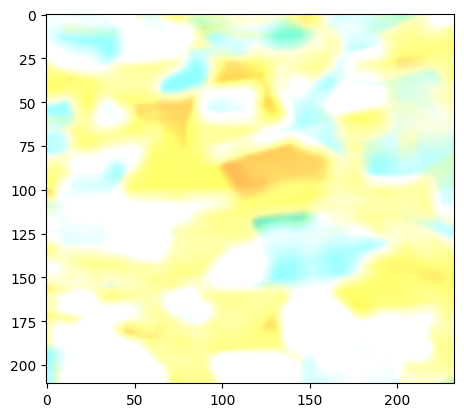

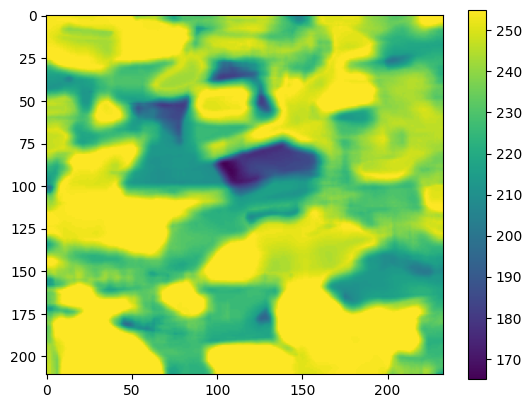

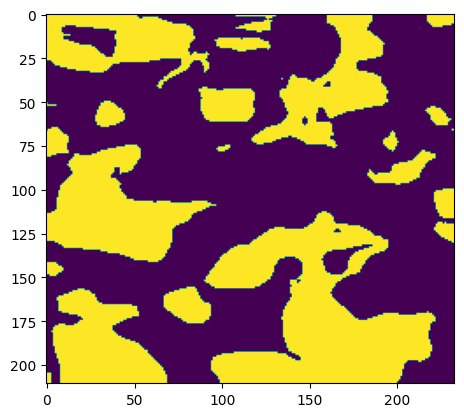

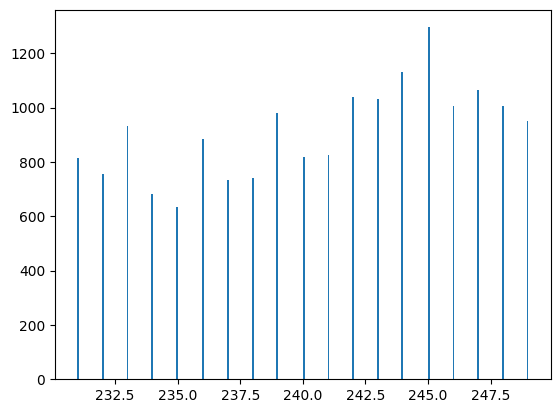

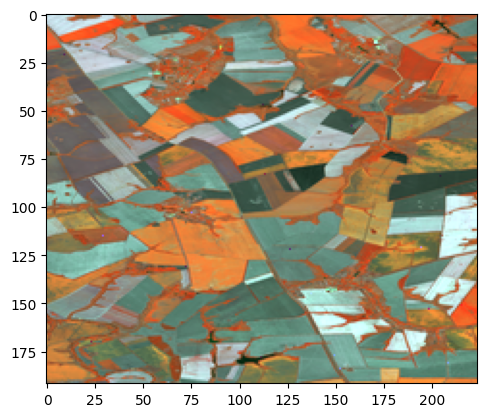

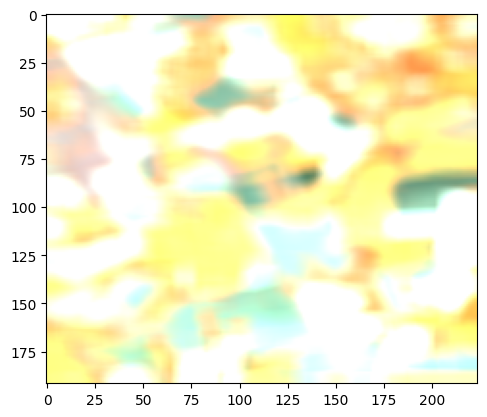

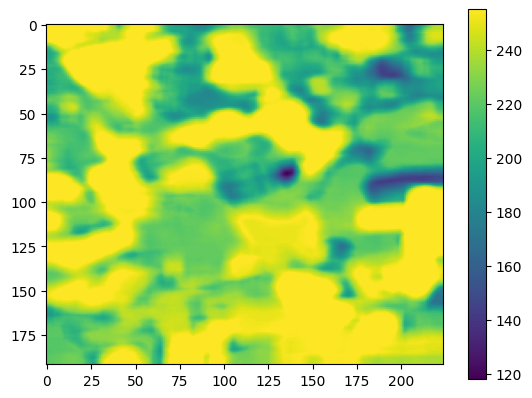

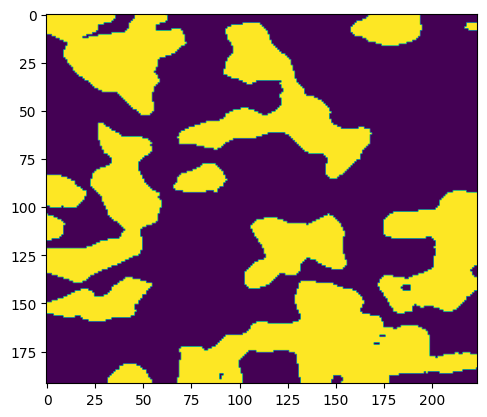

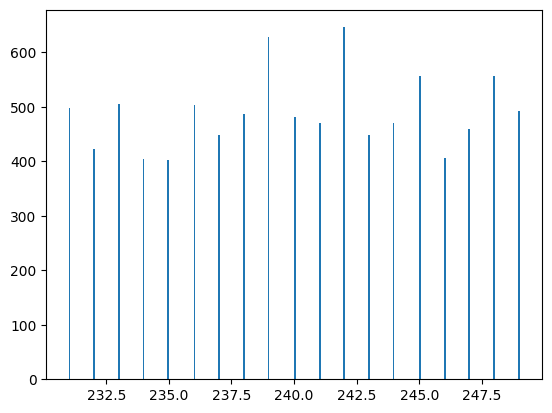

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:15: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))


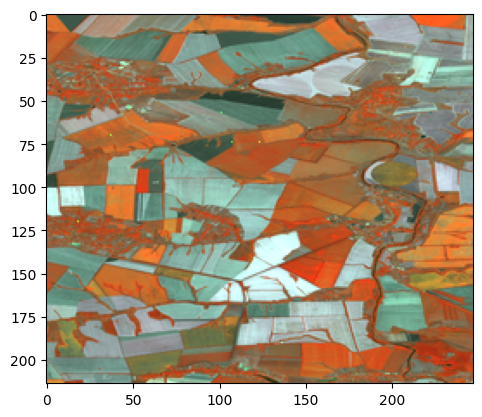

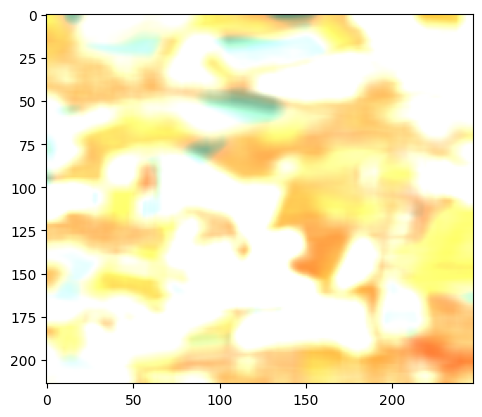

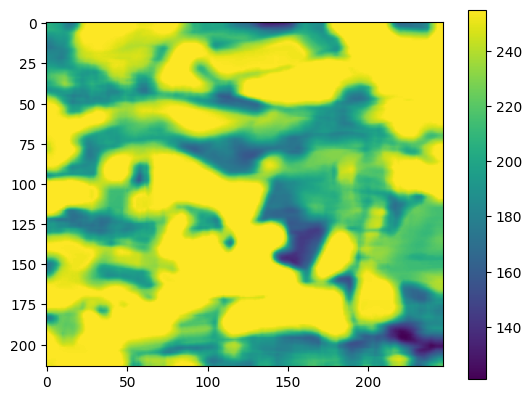

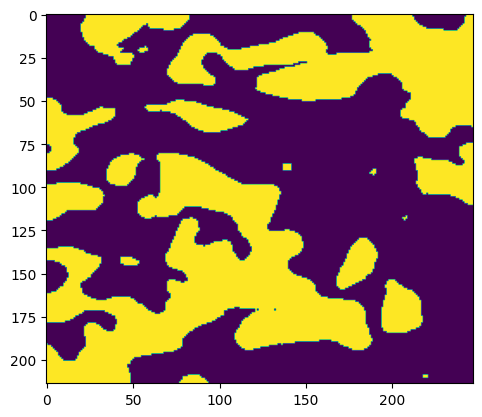

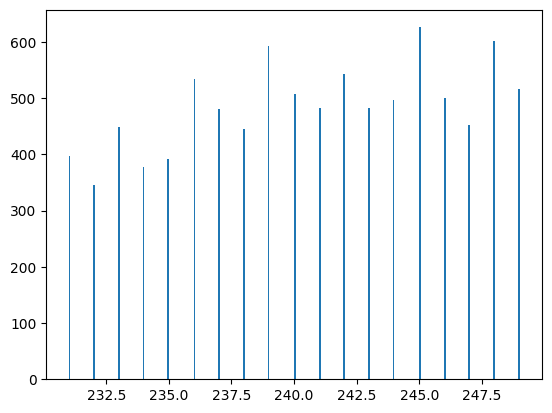

...

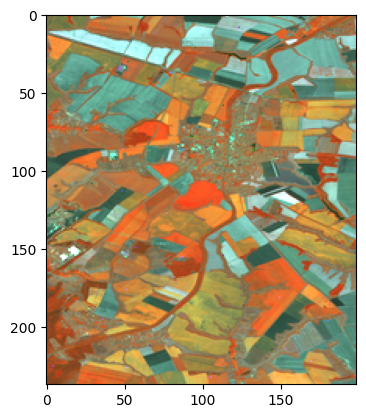

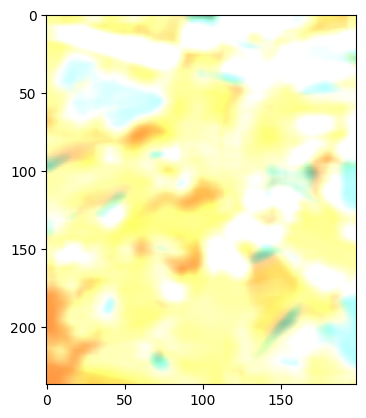

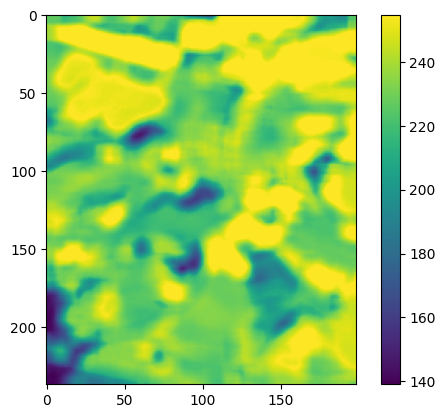

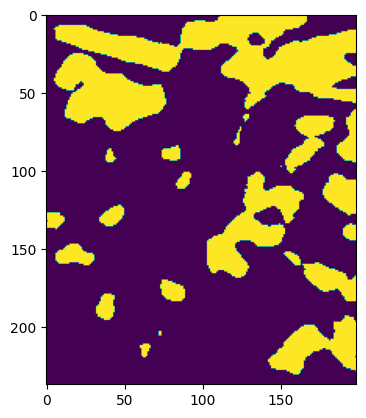

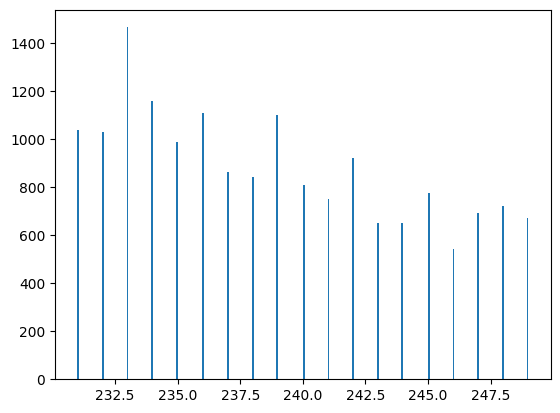

In [141]:
for i in range(19):
    #imshow(small_back.img, 'nir, g, b')
    #plt.imshow(calcus_NDVI(small_back.r, small_back.nir, True))
    img_cont = Scene(images[i], 0)
    #img_cont = img_cont.img[300:1500, :1500, :]
    imshow(img_cont.img, 'nir, g, b')
    kernel = np.ones((11, 11),np.float32)/55
    sharpened_image = cv2.filter2D(normalized_filtered(img_cont.img, 'nir, g, b'), -1, kernel)
    plt.imshow(sharpened_image)
    plt.show()
    gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
    plt.imshow(gray_image)
    plt.colorbar()
    plt.show()
    tmp = gray_image.copy()
    trh = 246
    tmp[tmp>trh] = 255
    tmp[tmp<=trh] = 0
    plt.imshow(tmp)
    plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/islands/'  + str(i) + r".png", tmp, cmap='gray', dpi=300)
    plt.show()
    plt.hist(gray_image[(gray_image>230)& (gray_image<250)].ravel(), bins=256)
    
    plt.show()

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:98

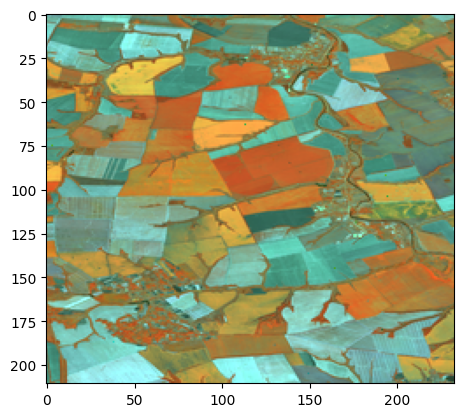

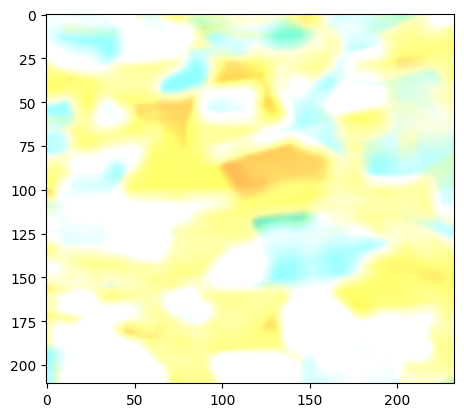

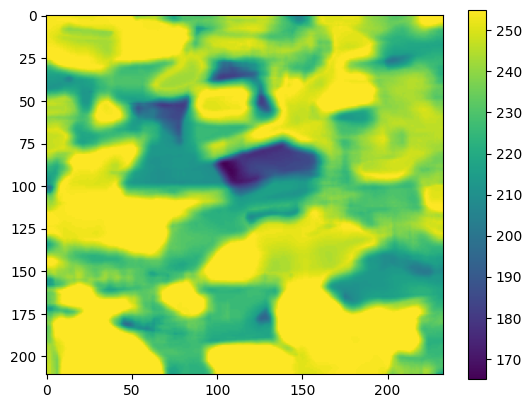

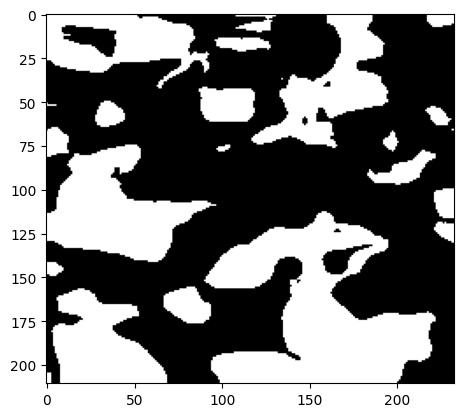

(array([ 816.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,  757.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,  932.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,  682.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,  636.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,  884.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,  735.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
         741.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,  979.,    0.,    0.,    0.,
           0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
      

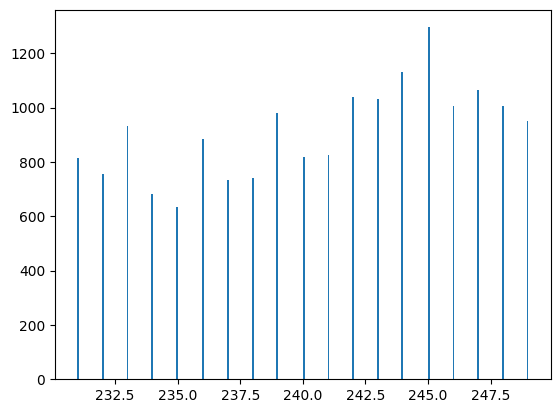

In [142]:
#imshow(small_back.img, 'nir, g, b')
#plt.imshow(calcus_NDVI(small_back.r, small_back.nir, True))
img_cont = Scene(images[0], 0)
#img_cont = img_cont.img[300:1500, :1500, :]
imshow(img_cont.img, 'nir, g, b')
kernel = np.ones((11, 11),np.float32)/55
sharpened_image = cv2.filter2D(normalized_filtered(img_cont.img, 'nir, g, b'), -1, kernel)
plt.imshow(sharpened_image)
plt.show()
gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
plt.imshow(gray_image)
plt.colorbar()
plt.show()
tmp = gray_image.copy()
trh = 246
tmp[tmp>trh] = 255
tmp[tmp<=trh] = 0
plt.imshow(tmp, cmap='gray')
plt.show()
plt.hist(gray_image[(gray_image>230)& (gray_image<250)].ravel(), bins=256)

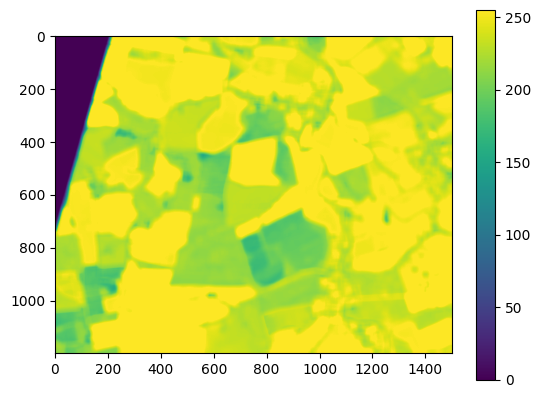

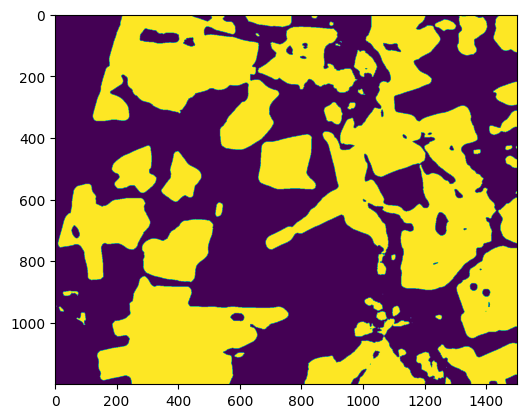

(array([31312.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0., 25287.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0., 30830.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0., 23158.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
        21887.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0., 27787.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0., 16936.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0.,     0.,     0., 15301.,     0.,     0.,     0.,     0.,
            0.,     0.,     0.,     0.,     0.,     0.,     0., 

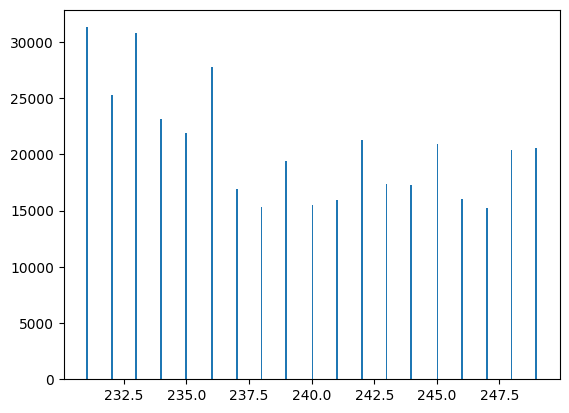

121 255
187 255
81 255


IndexError: index 3 is out of bounds for axis 2 with size 3

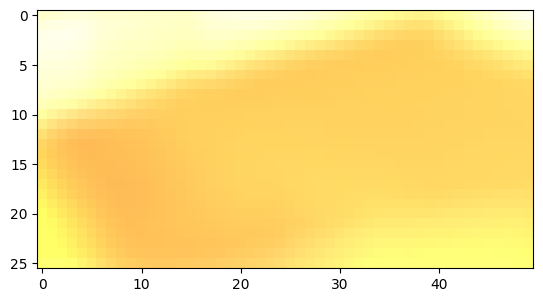

In [104]:
plt.imshow(sharpened_image[74:100, 100:150, :])
for i in range(4):
    print(np.min(sharpened_image[:,:, i]), np.max(sharpened_image[:,:, i]))


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:15: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_22080\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipyk

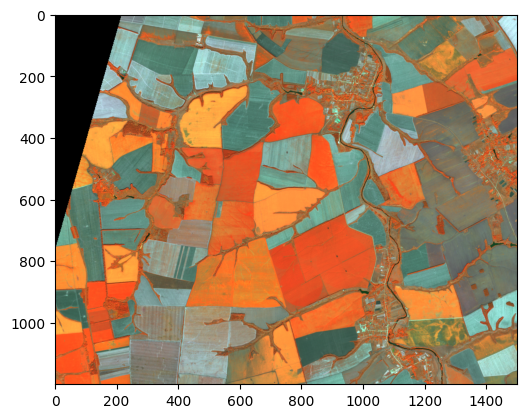

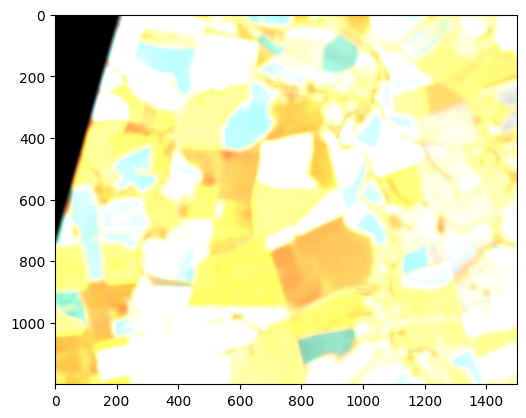

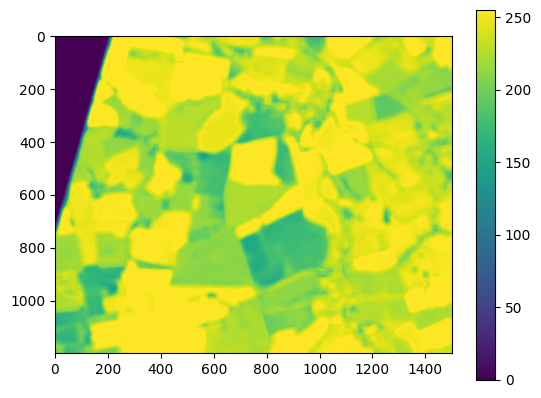

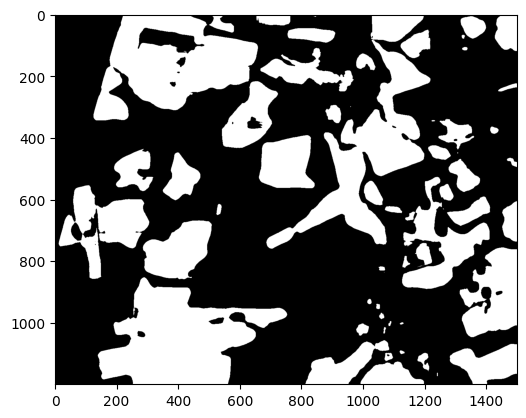

(array([7.15720e+04, 2.67000e+02, 2.46000e+02, 2.61000e+02, 2.23000e+02,
        1.74000e+02, 1.64000e+02, 1.24000e+02, 1.11000e+02, 1.38000e+02,
        8.80000e+01, 1.26000e+02, 9.80000e+01, 1.02000e+02, 8.10000e+01,
        9.50000e+01, 9.80000e+01, 8.20000e+01, 9.70000e+01, 8.60000e+01,
        8.60000e+01, 6.50000e+01, 1.00000e+02, 5.80000e+01, 6.50000e+01,
        9.00000e+01, 5.80000e+01, 6.60000e+01, 7.70000e+01, 5.80000e+01,
        6.40000e+01, 6.70000e+01, 7.30000e+01, 5.70000e+01, 6.40000e+01,
        5.70000e+01, 6.40000e+01, 5.90000e+01, 5.60000e+01, 5.40000e+01,
        6.90000e+01, 5.50000e+01, 6.00000e+01, 5.40000e+01, 5.70000e+01,
        5.50000e+01, 6.70000e+01, 4.40000e+01, 5.90000e+01, 5.50000e+01,
        4.80000e+01, 5.40000e+01, 5.20000e+01, 5.60000e+01, 4.80000e+01,
        6.00000e+01, 4.60000e+01, 6.00000e+01, 5.50000e+01, 4.10000e+01,
        4.40000e+01, 6.50000e+01, 5.90000e+01, 4.80000e+01, 4.90000e+01,
        4.70000e+01, 5.00000e+01, 6.70000e+01, 4.90

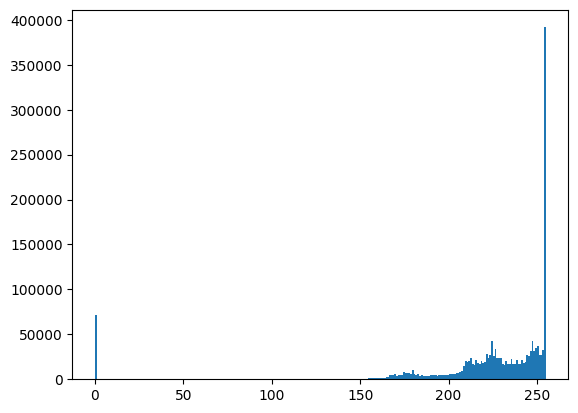

In [143]:
#imshow(small_back.img, 'nir, g, b')
#plt.imshow(calcus_NDVI(small_back.r, small_back.nir, True))
masks[0][:1000, :1000, :]
small_back = Scene(masks[0][:7000, :7000, :], 1)
back_crop = small_back.img[300:1500, :1500, :]
imshow(back_crop, 'nir, g, b')
kernel = np.ones((25, 25),np.float32)/260
sharpened_image = cv2.filter2D(normalized_filtered(back_crop, 'nir, g, b'), -1, kernel)
plt.imshow(sharpened_image)
plt.show()
gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
# Может быть добавить контраста
plt.imshow(gray_image)
plt.colorbar()
plt.show()
tmp = gray_image.copy()
trh = 246
tmp[tmp>trh] = 255
tmp[tmp<=trh] = 0
plt.imshow(tmp, cmap='gray')
plt.show()
plt.hist(gray_image.ravel(), bins=256)


In [ ]:
https://stackoverflow.com/questions/52748270/how-to-remove-image-noise-using-opencv-python

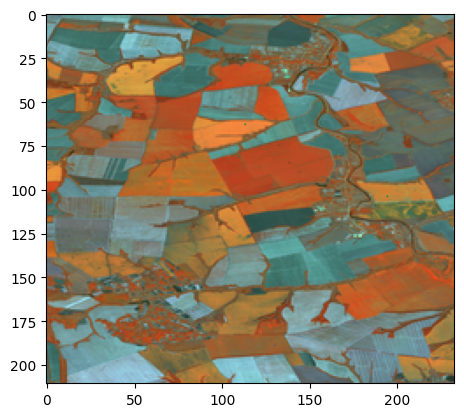

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_9860\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_9860\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


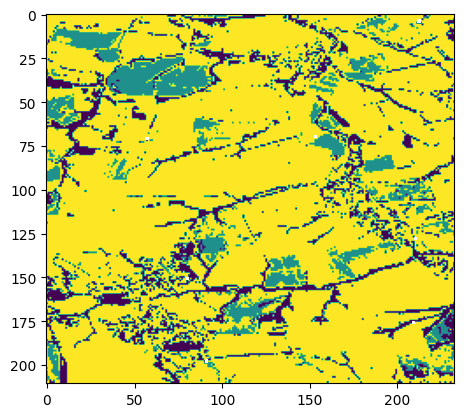

In [50]:
imshow(img.img, 'nir, g, b')#[:100, :100, :]
plt.imshow(calcus_NDVI(img.r, img.nir, True))

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:98

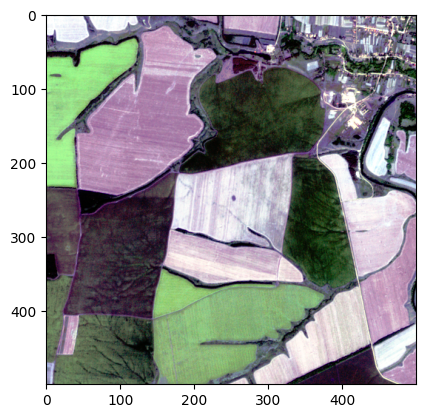

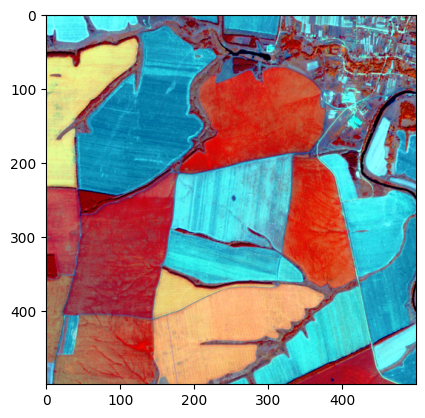

(500, 500, 3)


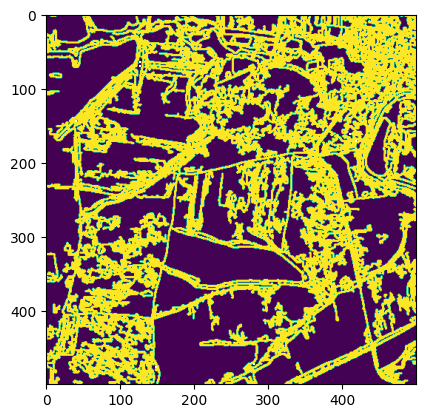

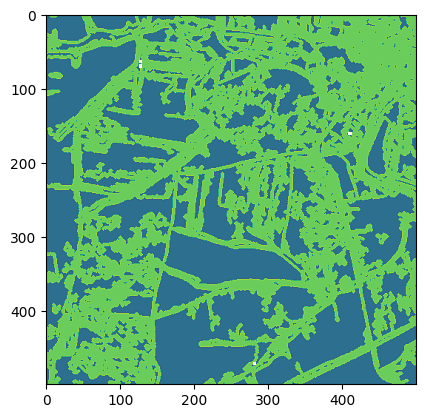

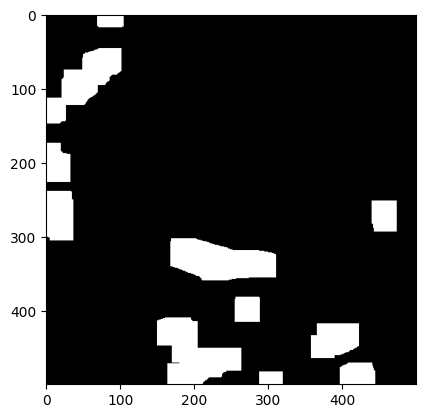

In [95]:
#img = scenes[19]
img = masks[0][500:1000, 500:1000, :]
img = Scene(img, 1)
ch_channels = 'nir, g, b'
imshow(img.img, 'r, g, b', True)
imshow(img.img, ch_channels, True)
#plt.imshow(calcus_NDVI(img.r, img.nir, True))
#plt.show()
im = normalized_filtered(img.img, ch_channels, True)#[:100, :100, :]
#im = calcus_NDVI(img.r, img.nir)
print(im.shape)
gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY) 
edged = cv2.Canny(gray, 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
im = calcus_NDVI(img.r, img.nir)
plt.imshow(cv2.drawContours(im, contours, -1, (255, 1, 1), 2))
contoured = cv2.drawContours(im, contours, -1, (255, 0, 1), 4)
plt.show()
kernel = np.array([[-1/9,-1/9,-1/9], [-1/9,17/9,-1/9], [-1/9,-1/9,-1/9]])
#Laplacian operator, sharpening filter L/
#kernel = np.array([[-0,-1/4,0], [-1/4, 2,-1/4], [0,-1/4,0]])
sharpened_image = cv2.filter2D(contoured, -1, kernel)
plt.imshow(sharpened_image)
plt.show()
#opening
#sharpened_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)

binr = cv2.threshold(sharpened_image, 0, 255, 
                     cv2.THRESH_BINARY)[1] 
  
# define the kernel 
kernel = np.ones((3, 3), np.uint8) 
  
# opening the image 
opening = cv2.morphologyEx(binr,  cv2.MORPH_OPEN, 
                           kernel, iterations=15) 
# print the output 
plt.imshow(opening, cmap='gray') 


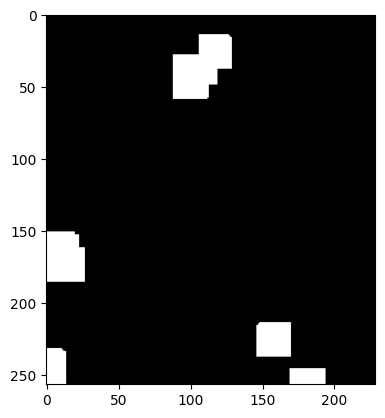

In [212]:
#cv2.imwrite(r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\city_masks\00", opening)
name = "crop_4_3_0000"
plt.imshow(opening, cmap='gray') 
plt.savefig(r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\city_masks\\" + name + r".png")

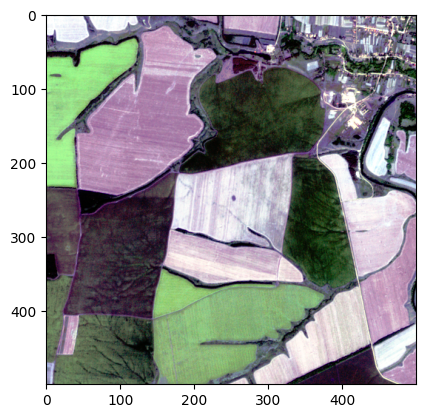

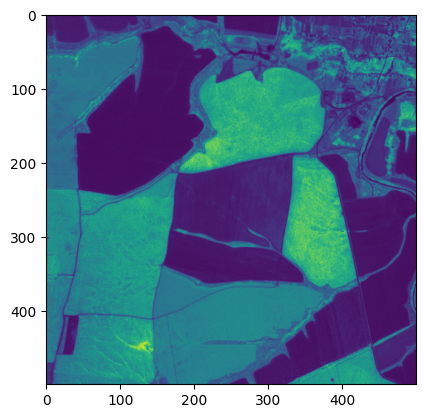

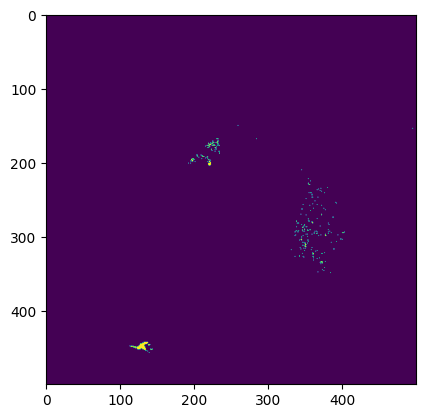

In [96]:
#img = scenes[3]
imshow(img.img, 'r, g, b', True)
plt.imshow(calcus_RVI(img.r, img.nir))
plt.show()
plt.imshow(calcus_RVI(img.r, img.nir, True))
plt.show()

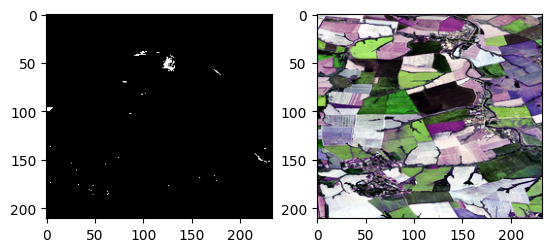

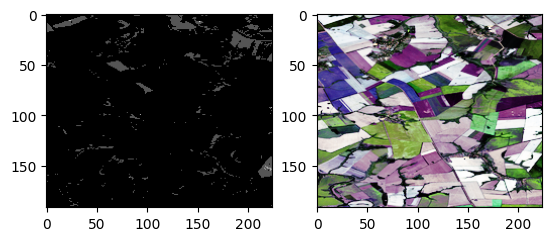

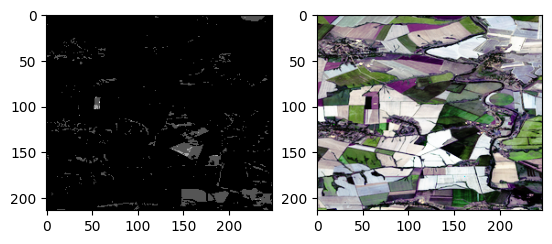

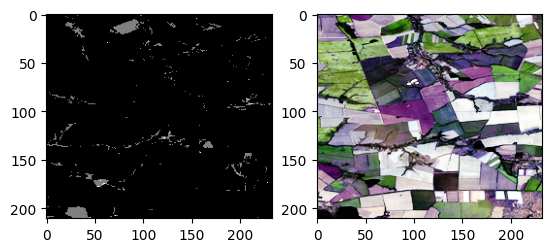

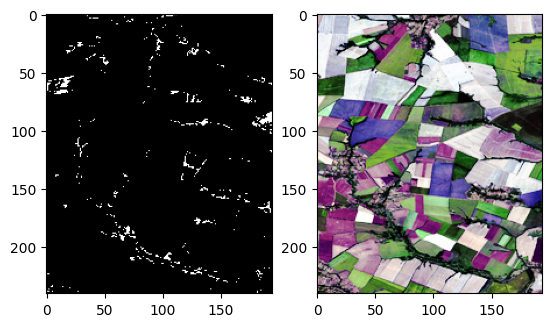

...

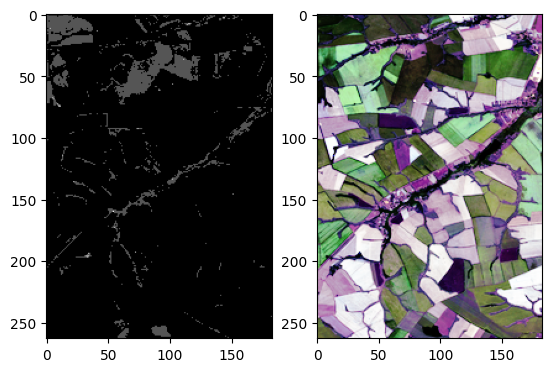

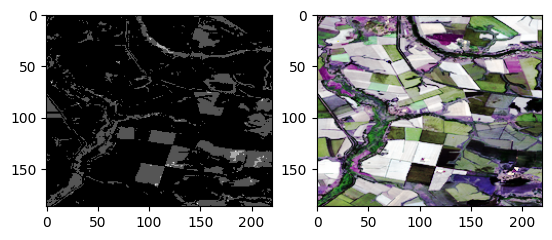

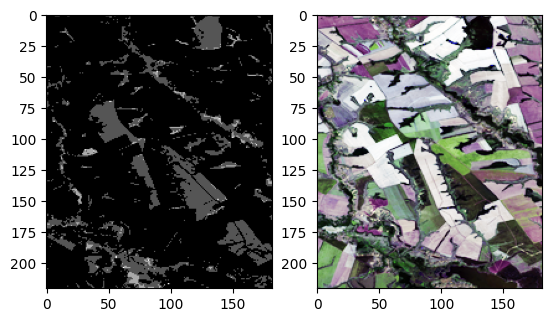

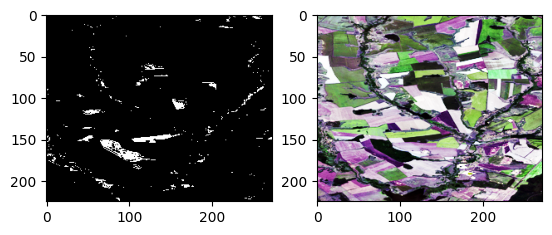

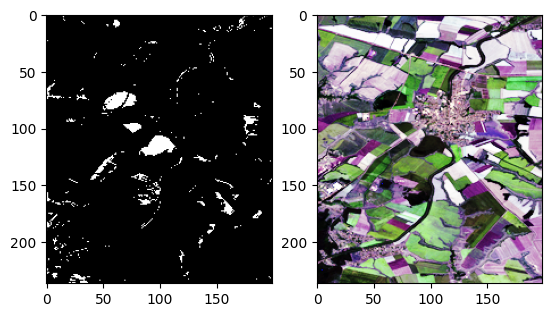

In [284]:
file_names =  ['crop_0_0_0000.tif', 'crop_0_1_0000.tif', 'crop_0_2_0000.tif', 'crop_0_3_0000.tif', 'crop_1_0_0000.tif', 'crop_1_1_0000.tif', 'crop_1_2_0000.tif', 'crop_1_3_0000.tif', 'crop_2_0_0000.tif', 'crop_2_1_0000.tif', 'crop_2_2_0000.tif', 'crop_2_3_0000.tif', 'crop_3_0_0000.tif', 'crop_3_1_0000.tif', 'crop_3_2_0000.tif', 'crop_3_3_0000.tif', 'crop_4_0_0000.tif', 'crop_4_1_0000.tif', 'crop_4_2_0000.tif', 'crop_4_3_0000.tif']
for j in range(19):
    img = scenes[j]
    name = file_names[j]
    plt.subplot(1, 2, 1)  # row 1, column 2, count 1
    i = calcus_RVI(img.r, img.nir, True)
    #i = i/np.max(i)
    plt.imshow(i, cmap='gray')
    plt.savefig(r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\rivers_masks\\" + name + r".png", dpi=300)
    #plt.colorbar()
    
    plt.subplot(1, 2, 2)  # row 1, column 2, count 1
    imshow(img.img, 'r, g, b', True)
    #plt.imshow(calcus_RVI(img.r, img.nir))
    #plt.colorbar()
    #plt.show()
    plt.show()

    ret,thresh = cv2.threshold(i,1,255,cv2.THRESH_BINARY)
    plt.imsave(r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\rivers_masks\\" + name + r".png", thresh, cmap='gray')
    #plt.savefig(r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\rivers_masks\\" + name + r".png", dpi=300)
    #print(thresh1)
    #plt.imshow(thresh1)
    plt.show()

In [ ]:
img = scenes[19]
ch_channels = 'nir, g, b'
imshow(img.img, 'r, g, b', True)
imshow(img.img, ch_channels, True)
#plt.imshow(calcus_NDVI(img.r, img.nir, True))
#plt.show()
im = normalized_filtered(img.img, ch_channels, True)#[:100, :100, :]
#im = calcus_NDVI(img.r, img.nir)
print(im.shape)
gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY) 
edged = cv2.Canny(gray, 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
im = calcus_NDVI(img.r, img.nir)
plt.imshow(cv2.drawContours(im, contours, -1, (255, 1, 1), 2))
contoured = cv2.drawContours(im, contours, -1, (255, 0, 1), 4)
plt.show()
kernel = np.array([[-1/9,-1/9,-1/9], [-1/9,17/9,-1/9], [-1/9,-1/9,-1/9]])
#Laplacian operator, sharpening filter L/
#kernel = np.array([[-0,-1/4,0], [-1/4, 2,-1/4], [0,-1/4,0]])
sharpened_image = cv2.filter2D(contoured, -1, kernel)
plt.imshow(sharpened_image)
plt.show()
#opening
#sharpened_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)

binr = cv2.threshold(sharpened_image, 0, 255, 
                     cv2.THRESH_BINARY)[1] 
  
# define the kernel 
kernel = np.ones((3, 3), np.uint8) 
  
# opening the image 
opening = cv2.morphologyEx(binr,  cv2.MORPH_OPEN, 
                           kernel, iterations=10) 
# print the output 
plt.imshow(opening, cmap='gray') 


In [328]:
img = img = scenes[0]
#im = normalized_filtered(img.img, 'nir, g, b')#[:100, :100, :]
im = calcus_NDVI(img.r, img.nir)
print(im.shape)
#gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY) 
edged = cv2.Canny(gray, 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 


(211, 233)


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


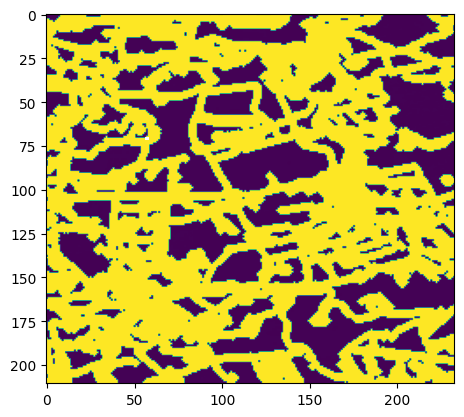

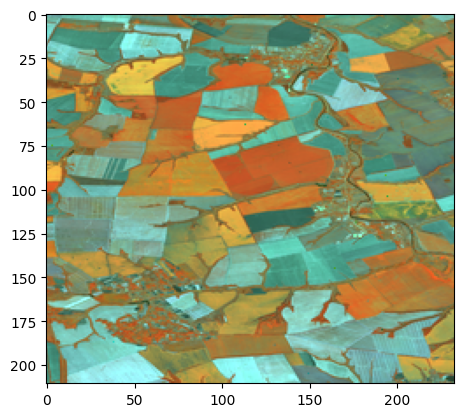

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


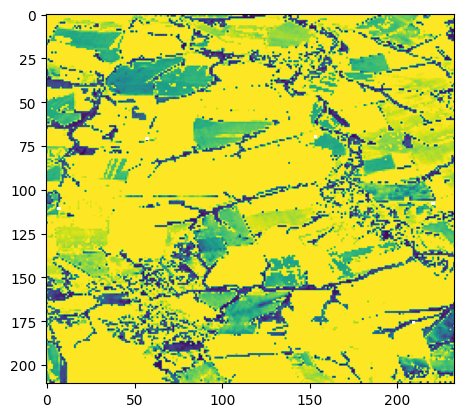

In [329]:
plt.imshow(cv2.drawContours(im, contours, -1, (255, 1, 1), 4) )
contoured = cv2.drawContours(im, contours, -1, (255, 0, 0), 1)
plt.show()
imshow(img.img, 'nir, g, b')
plt.imshow(calcus_NDVI(img.r, img.nir))

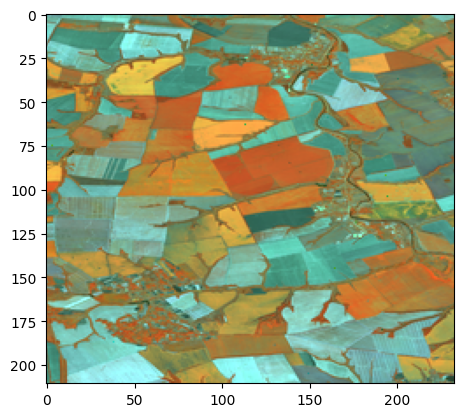

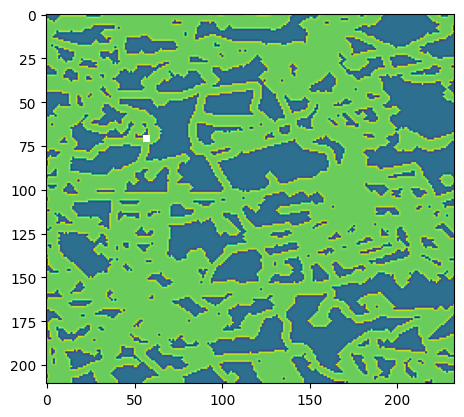

In [330]:
imshow(img.img, 'nir, g, b')
#plt.show()
#kernel = np.ones((11, 11),np.float32)/1000
# sharpening filter
kernel = np.array([[-1/9,-1/9,-1/9], [-1/9,17/9,-1/9], [-1/9,-1/9,-1/9]])
sharpened_image = cv2.filter2D(contoured, -1, kernel)
plt.imshow(sharpened_image)
plt.show()

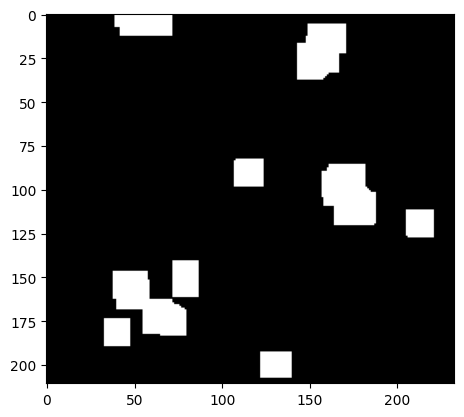

: 

In [332]:
#opening
#g_im = cv2.cvtColor(contoured, cv2.COLOR_BGR2GRAY)

binr = cv2.threshold(sharpened_image, 0, 255, 
                     cv2.THRESH_BINARY)[1] 
  
# define the kernel 
kernel = np.ones((3, 3), np.uint8) 
  
# opening the image 
opening = cv2.morphologyEx(binr,  cv2.MORPH_OPEN, 
                           kernel, iterations=7) 
# print the output 
plt.imshow(opening, cmap='gray') 

In [ ]:
cv2.findContours()
cv2.morphologyEx

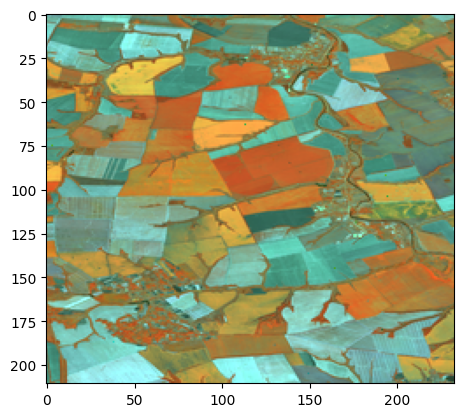

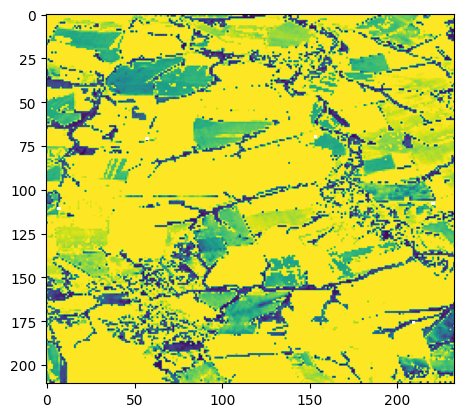

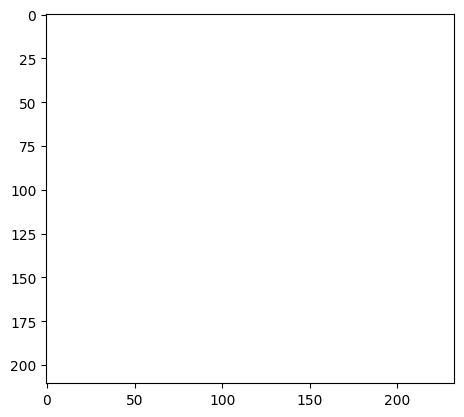

In [203]:
img = scenes[0]
imshow(img.img, 'nir, g, b')
plt.imshow(img.NDVI)
plt.show()
#Sharp_modified = ImageEnhance.Sharpness(Image.fromarray(calcus_NDVI(img.r, img.nir, True)))
#kernel = np.ones((5,5),np.float32)/0.1 #np.array([[1, 1, -1], [-1, 5, -1], [0, -1, 0]])
#sharpened_image = cv2.filter2D(calcus_NDVI(img.r, img.nir, True), -1, kernel) 
#kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
#Laplacian operator, sharpening filter L/
#kernel = np.array([[-0,-1/4,0], [-1/4, 2,-1/4], [0,-1/4,0]])
# sharpening filter
#kernel = np.array([[-1/9,-1/9,-1/9], [-1/9,17/9,-1/9], [-1/9,-1/9,-1/9]])
#kernel = np.array([[1/9,1/9,1/9], [1/9,0,1/9], [1/9,1/9,1/9]])
sharpened_image = cv2.filter2D(normalized_filtered(img.img, 'nir, g, b'), -1, kernel) 
#sharpened_image = cv2.filter2D(calcus_NDVI(img.r, img.nir, True), -1, kernel) 
#sharpened_image = cv2.filter2D(sharpened_image, -1, kernel) 
#sharpened_image = cv2.filter2D(sharpened_image, -1, kernel) 
#sharpened_image = cv2.filter2D(sharpened_image, -1, kernel) 
plt.imshow(sharpened_image)
#plt.imshow(Sharp_modified.enhance(10.0))
plt.show()

Большой вылетающий пиксель

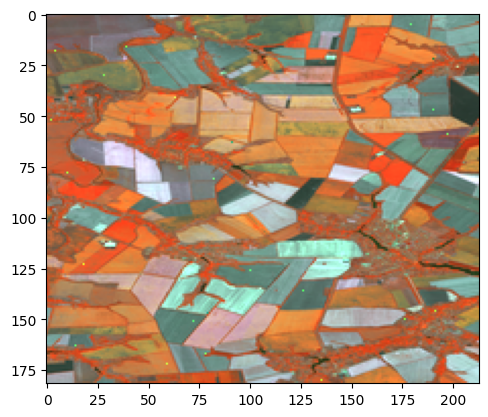

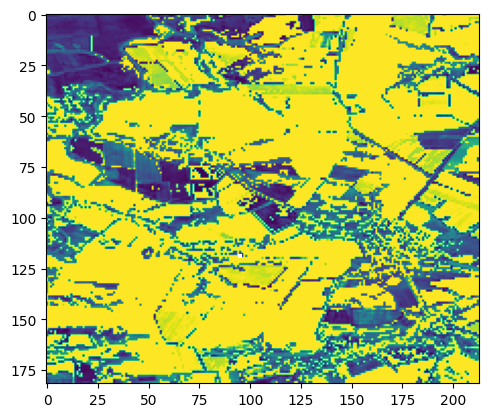

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


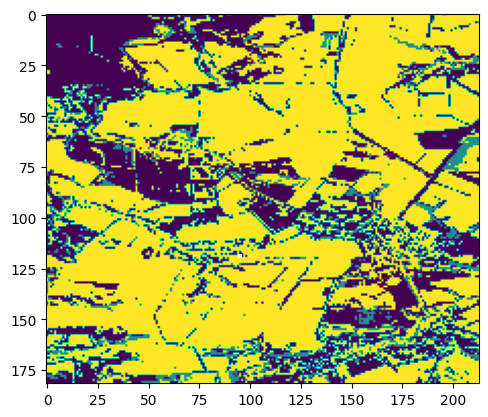

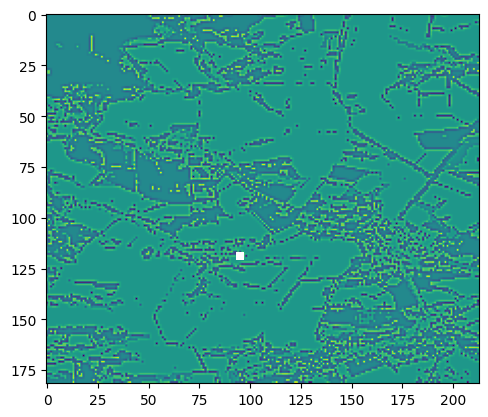

In [124]:
img = scenes[5]
imshow(img.img, 'nir, g, b')
plt.imshow(img.NDVI)
plt.show()
plt.imshow(calcus_NDVI(img.r, img.nir, True))
plt.show()
#Sharp_modified = ImageEnhance.Sharpness(Image.fromarray(calcus_NDVI(img.r, img.nir, True)))
kernel = np.ones((5,5),np.float32)/0.1 #np.array([[1, 1, -1], [-1, 5, -1], [0, -1, 0]])
#sharpened_image = cv2.filter2D(calcus_NDVI(img.r, img.nir, True), -1, kernel) 
kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
#sharpened_image = cv2.filter2D(normalized_filtered(img.img, 'nir, g, b'), -1, kernel) 
sharpened_image = cv2.filter2D(calcus_NDVI(img.r, img.nir, True), -1, kernel) 
plt.imshow(sharpened_image)
#plt.imshow(Sharp_modified.enhance(10.0))
plt.show()

In [ ]:
print('Изменяем яркость')
Brt_modified = ImageEnhance.Brightness(modified)  
plt.imshow(Brt_modified.enhance(.5))
plt.show()
print('Изменяем резкость')
Sharp_modified = ImageEnhance.Sharpness(modified)
plt.imshow(Sharp_modified.enhance(-10.0))
plt.show()
print('Изменяем контрастность')
Cont_modified = ImageEnhance.Contrast(modified)
plt.imshow(Cont_modified.enhance(5.0))
plt.show()
print('Изменяем цветовой баланс')
Clr_modified = ImageEnhance.Color(modified)
plt.imshow(Clr_modified.enhance(5.0))
plt.show()

In [ ]:
imshow()
imshow(scene[18].row_img, '', hist_equal: bool = False):

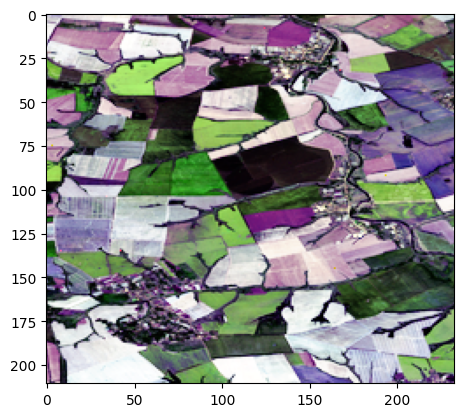

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


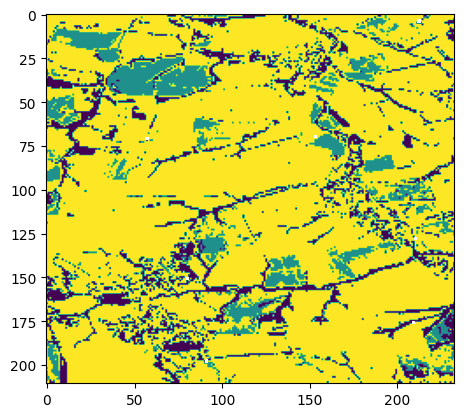

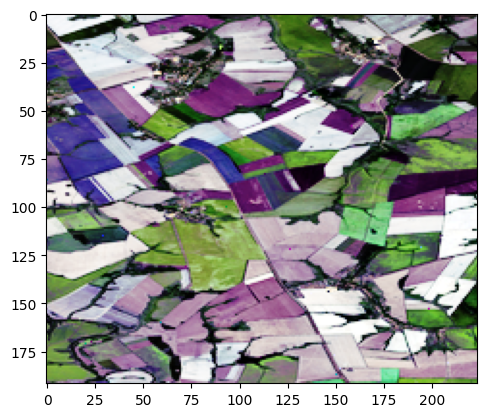

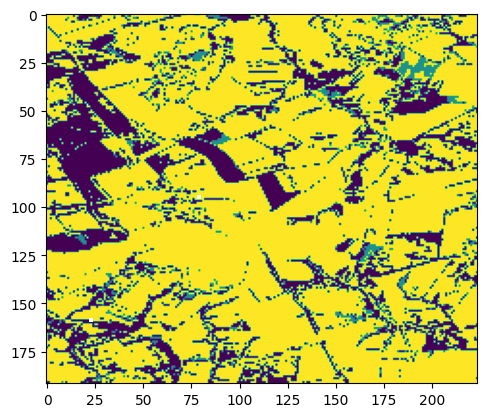

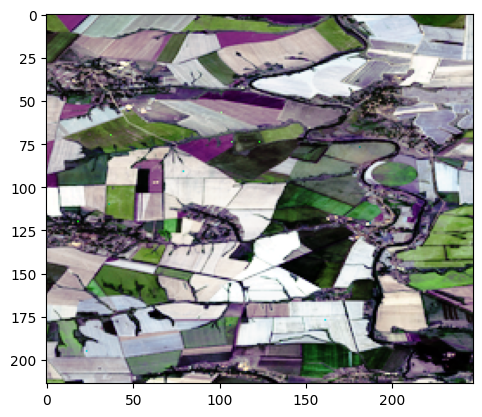

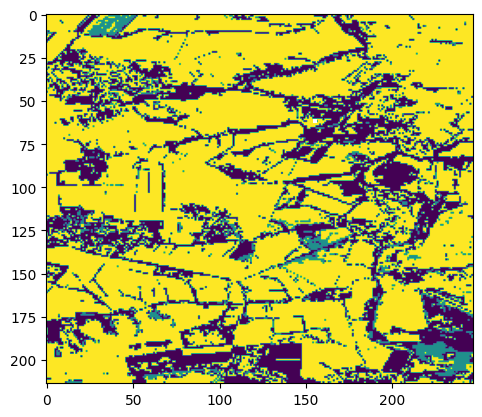

In [46]:
for i in range(3):
    imshow(scenes[i].row_img, 'r, g, b', True)
    plt.imshow(calcus_NDVI(scenes[i].r, scenes[i].nir, True))
    plt.colorbar
    plt.show()

(array([1552., 8062., 8179., 9626., 5950., 4969., 4510., 3470., 1829.,
        1016.]),
 array([ 70. ,  88.5, 107. , 125.5, 144. , 162.5, 181. , 199.5, 218. ,
        236.5, 255. ]),
 <BarContainer object of 10 artists>)

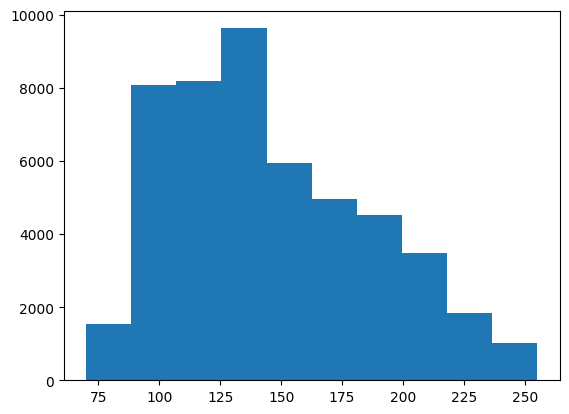

In [16]:
plt.hist(scenes[0].r.ravel())

## Нарезаем подложку и Создаём объекты класса
Размер картинки + 10%

In [49]:
def cut_image_into_parts(image, h, w):
    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            
            # Append the part to the list
            parts.append(part)
    
    return parts

In [7]:
scenes = []
for img in images:
    scenes.append(Scene(img, 0))

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:47: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:98: Runti

In [10]:
image_of_interest_index = 0

In [11]:
choosed_img = scenes[image_of_interest_index].row_img
h, w = choosed_img.shape[:-1]
print(w, h)
w = int(w)
h = int(h)
print(w, h)

crop_back = cut_image_into_parts(masks[0], h, w)

233 211
233 211


In [12]:
scenes_mask = []
i = 0
#for m in masks:
for m in crop_back:
    if i == 1:
        break
    scenes_mask.append(Scene(m, 1))

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:98: RuntimeWarning: invalid value encountered in divide
  NDWI = (g-nir)/(g+nir)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_11992\1583987627.py

## Ищем ближайших соседей

In [ ]:
mask_all_layers = []
i = 0
for m in scenes_mask:
    if i == 9:
        break
    i+=1
    mask_all_layers.append(m.NDVI)
dataset = np.array(mask_all_layers)
print(dataset.shape)

(10, 182, 213)


In [ ]:
# Assuming target_image and dataset are given as np.arrays with shape (height, width, 6)
target_image =   scenes[0].NDVI

# Flatten each image into a 1D array
target_image_flat = target_image.flatten()
dataset_flat = dataset.reshape((dataset.shape[0], -1))
#---------КОСТЫЛЬ----------------------
dataset_flat = np.nan_to_num(dataset_flat)
#---------КОСТЫЛЬ----------------------

# Initialize and fit the NearestNeighbors model
nbrs = NearestNeighbors(n_neighbors=1, algorithm='auto').fit(dataset_flat)

# Find the nearest neighbor to the target image
distances, indices = nbrs.kneighbors([target_image_flat])

# The most similar image
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"The most similar image is at index {most_similar_image_index}")


The most similar image is at index 2


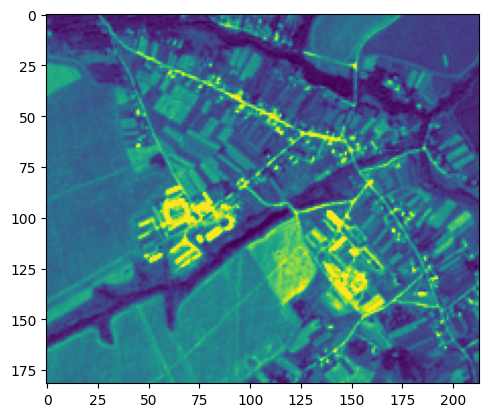

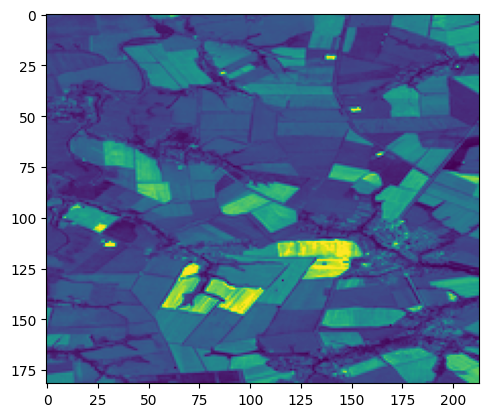

In [47]:
plt.imshow(dataset[2])
plt.show()
plt.imshow(scenes[5].r)

In [48]:
img_num = 3

choosed_img = scenes[img_num].row_img
h, w = choosed_img.shape[:-1]
print(w, h)
w = int(w)
h = int(h)
print(w, h)
crop_back = cut_image_into_parts(masks[0], h, w)
scenes_mask = []
i = 0
#for m in masks:
for m in crop_back:
    if i == 15:
        break
    scenes_mask.append(Scene(m, 1))


target_image =   scenes[img_num].r

# Flatten each image into a 1D array
target_image_flat = target_image.flatten()
dataset_flat = dataset.reshape((dataset.shape[0], -1))
#---------КОСТЫЛЬ----------------------
dataset_flat = np.nan_to_num(dataset_flat)
#---------КОСТЫЛЬ----------------------

# Initialize and fit the NearestNeighbors model
nbrs = NearestNeighbors(n_neighbors=1, algorithm='auto').fit(dataset_flat)

# Find the nearest neighbor to the target image
distances, indices = nbrs.kneighbors([target_image_flat])

# The most similar image
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"The most similar image is at index {most_similar_image_index}")


233 211
233 211


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:47: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:98: RuntimeWarning: invalid value encountered in divide
  NDWI = (g-nir)/(g+nir)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_16172\1583987627.py

ValueError: X has 49163 features, but NearestNeighbors is expecting 38766 features as input.

In [98]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
import tifffile
from sklearn.neighbors import NearestNeighbors

In [99]:
base_path = 'C:/Users/Maria Smirnova/Desktop/Проекты/LDT/scenes'
mask_key_word = 'layout'
files_format = ['tif']

images = [] 
masks = []
for address, dirs, files in os.walk(base_path):
    #print(address, dirs, files)
    for f in files:
            if f.endswith('tif'):
                file_path = os.path.join(address, f)
                if (mask_key_word in f):
                    if f  == 'layout_2021-08-16.tif':
                        #masks.append(Image.open(file_path))
                        mask = tifffile.imread(file_path)
                        masks.append(mask)
                else:
                    #images.append(Image.open(file_path))
                    #images.append(Scene(tifffile.imread(file_path), 0))
                    images.append(tifffile.imread(file_path))

In [100]:
list_image = images

In [39]:
from skimage.transform import rescale

In [82]:
import numpy as np
from skimage.transform import rescale
import matplotlib.pyplot as plt

# Example image (random values for demonstration)
image = masks[0]

# Scaling factor
scale_factor = 8

# Scale the image
scaled_image = rescale(image, scale_factor, anti_aliasing=True)

#print(scaled_image)




In [106]:
scaled_image.shape

(106, 116, 2)

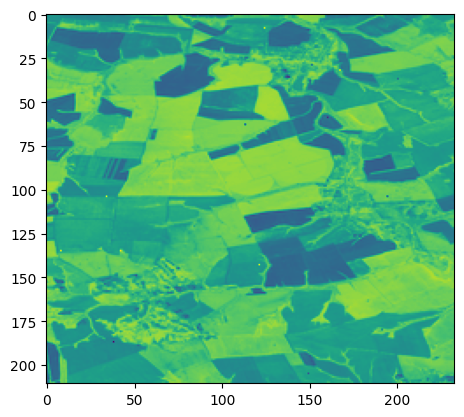

TypeError: Invalid shape (106, 116, 2) for image data

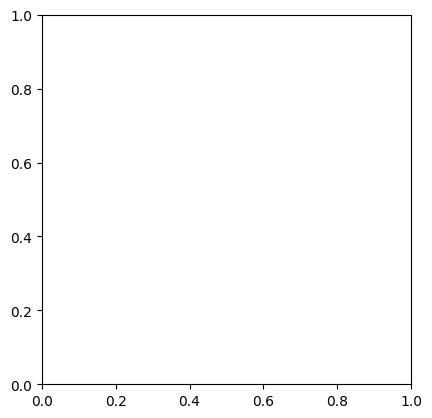

In [108]:
plt.imshow(calcus_NDVI(image[:,:, 0], image[:,:, 3]))
plt.show()
plt.imshow(scaled_image, cmap='gray')

In [45]:
def cut_image_into_parts(image, h, w):
    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    dict_pos = {}
    parts = []
    
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            dict_pos[i] = [start_row, start_col]
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            part = calcus_NDVI(part[:,:, 0], part[:,:, 3])
            scaled_image = rescale(image, 5, anti_aliasing=True)
            # Append the part to the list
            parts.append(part)
    
    return parts, dict_pos

In [4]:
def get_mean_neighbours(image, channel: int, x: int, y: int) -> int:
        neighbours = []
        rows, cols = image.shape[:-1]

        # Список смещений для всех возможных соседей
        offsets = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        for dy, dx in offsets:
            ny, nx = y + dy, x + dx
            if 0 <= nx < cols and 0 <= ny < rows:
                neighbours.append(image[ny][nx][channel])
        return round(np.mean(neighbours))

def calculate_thresholds(image):
    # Преобразование изображения в одномерный массив
    flattened_image = image.flatten()

    median_value = np.median(flattened_image)
    # Вычисление пороговых значений
    low_threshold = 0.15 * median_value
    high_threshold = 5.0 * median_value

    return low_threshold, high_threshold    

def fix(image):
    raster = image.copy()
    y, x = image.shape[:-1]
    for channel in range(image.shape[-1]):
        min_pixel, max_pixel = calculate_thresholds(raster[:, :,channel])
        # print(f'low is {min_pixel}, max is {max_pixel}')
        for i in range(y):
            for j in range(x):
                if raster[i][j][channel] < min_pixel or raster[i][j][channel] > max_pixel:
                    new_pixel = get_mean_neighbours(raster, channel, y=i, x=j)
                    #  task:    [номер строки]; [номер столбца]; [номер канала]; [«битое» значение]; [исправленное значение]
                    #print(f"[{i}];[{j}];[{channel + 1}];[{raster[i][j][channel]}];[{new_pixel}]")
                    raster[i][j][channel] = new_pixel
    return raster

In [97]:
for i in range(len(images)):
    images[i] = fix(images[i])
    images[i] = calcus_NDVI(images[i][:,:,0], images[i][:,:,3])

In [33]:
target_image.shape

(211, 233)

In [110]:
# Assuming target_image and dataset are given as np.arrays with shape (height, width, 6)
target_image =   images[0]
h, w = target_image.shape[:-1]

dataset, dict_pos = cut_image_into_parts(masks[0], h, w) 
dataset = np.array(dataset)
print(dataset.shape)

# Flatten each image into a 1D array
target_image_flat = target_image.flatten()
dataset_flat = dataset.reshape((dataset.shape[0], -1))
#---------КОСТЫЛЬ----------------------
dataset_flat = np.nan_to_num(dataset_flat)
#---------КОСТЫЛЬ----------------------

# Initialize and fit the NearestNeighbors model
nbrs = NearestNeighbors(n_neighbors=1, algorithm='auto').fit(dataset_flat)

# Find the nearest neighbor to the target image
distances, indices = nbrs.kneighbors([target_image_flat])

# The most similar image
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"The most similar image is at index {most_similar_image_index}")
#print(f"The most similar image is at index {most_similar_image_index},start at {dict_pos[most_similar_image_index]}")


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_14520\1714260137.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


MemoryError: Unable to allocate 449. GiB for an array with shape (54900, 54900, 20) and data type float64

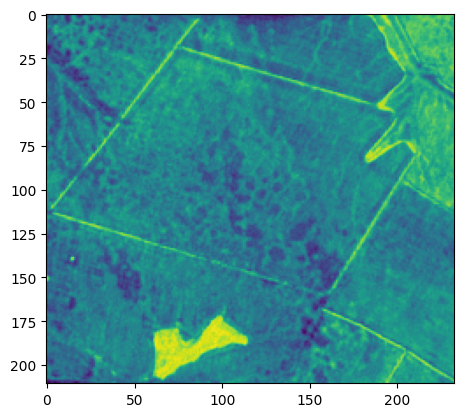

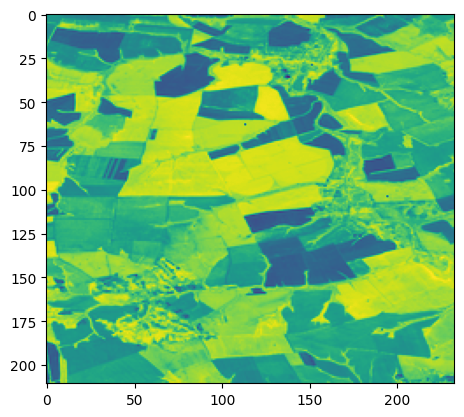

In [38]:
plt.imshow(dataset[912])
plt.show()
plt.imshow(target_image)



Смотрим тестовые данные

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_3932\1583987627.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


nan
nan


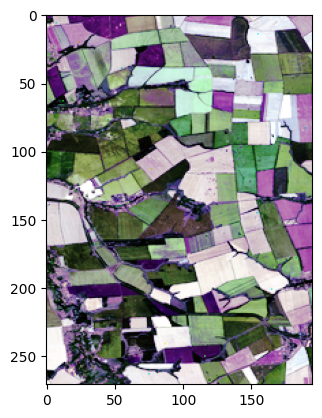

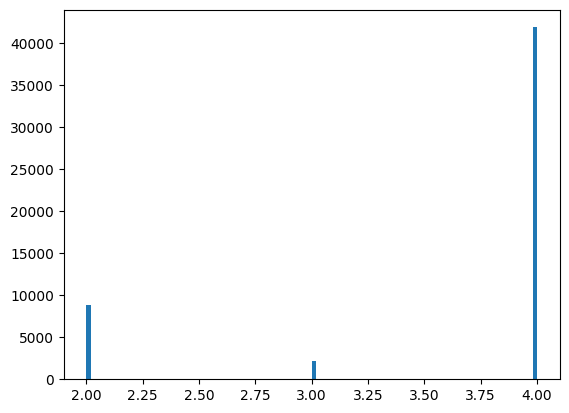

In [26]:
img = scenes[9]

#img.NDVI[img.NDVI>1] = 1
#img.EVI[img.EVI>1] = 1
#img.EVI[img.EVI<-1] = -1
#img.GNDVI[img.GNDVI>1] = 1
#img.GNDVI[img.GNDVI<-1] = -1
# MCARI нужна бинарная маска (можнет быть три градации)
#img.MCARI[img.MCARI>1] = 1
#img.MCARI[img.MCARI<0.9] = 0.9
#img.NDTI[img.NDTI<20] = 20
#img.NDWI[img.NDWI>55] = 55
#img.NDWI[img.NDWI<10] = 10

loi = calcus_NDVI(img.r, img.nir, True)
#loi = img.tass_cap
#loi = img.RVI
print(np.max(loi))
print(np.min(loi))
#plt.imshow(loi)
#plt.colorbar()
plt.show()
imshow(img.row_img, 'r, g, b', True)
plt.show()
plt.hist(loi.ravel(), bins=100)
plt.show()


Смотрим тестовый снимок

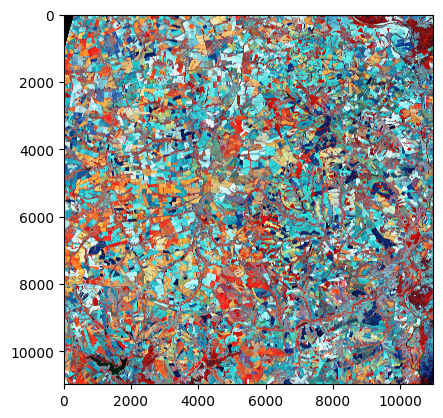

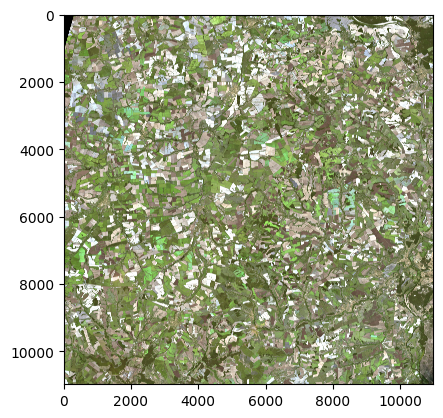

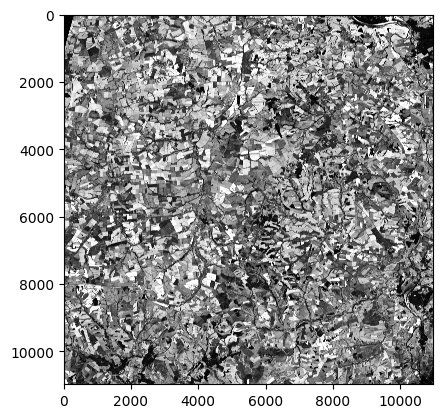

In [92]:
#image = images[5]
image = masks[0]
imshow(image, 'nir, g, b', True)
img = normalize(image, 85, 2)
plt.imshow(img[:,:, 0:3])

           
src = img[:,:, 0:3]
src = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)
dst = cv2.equalizeHist(src)
plt.show()
plt.imshow(dst,cmap='gray', vmin=0, vmax=255)


In [98]:
images[0].shape

(211, 233, 4)

coordinate: (9765, 2869) (9976, 3102)


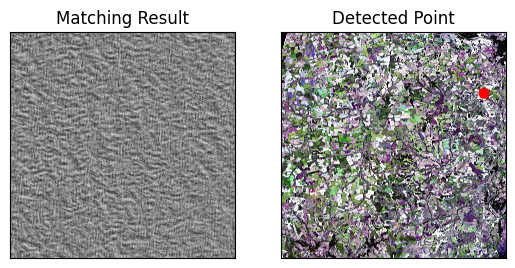

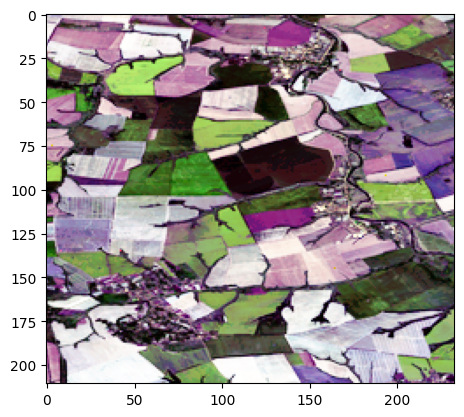

In [119]:
#img = cv2.imread('/home/hellomind/venera9/18. Sitronics/1_20/crop_0_0_0000.tif', cv2.IMREAD_GRAYSCALE)
#template = cv2.imread('/home/hellomind/venera9/18. Sitronics/layouts/layout_2021-08-16.tif', cv2.IMREAD_GRAYSCALE)
img = normalized_filtered(masks[0], 'r, g, b', True)
template = normalized_filtered(images[0], 'r, g, b', True)
w, h = template.shape[:-1]


# referance: https://docs.opencv.org/4.x/d4/dc6/tutorial_py_template_matching.html
method = eval("cv2.TM_CCOEFF_NORMED")
result = cv2.matchTemplate(img, template,method)

min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)
top_left = max_loc
bottom_right = (top_left[0] + w, top_left[1] + h)

cv2.rectangle(img, top_left, bottom_right, 255, 250)
print('coordinate:', top_left, bottom_right)

plt.subplot(121),plt.imshow(result,cmap = 'gray')
plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(img,cmap = 'gray')
plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(template)


In [74]:
pip install tqdm

     ---------------------------------------- 0.0/57.6 kB ? eta -:--:--
     --------------------- ------------------ 30.7/57.6 kB 1.3 MB/s eta 0:00:01
     --------------------------------- ---- 51.2/57.6 kB 518.5 kB/s eta 0:00:01
     -------------------------------------- 57.6/57.6 kB 378.5 kB/s eta 0:00:00
   ---------------------------------------- 0.0/78.3 kB ? eta -:--:--
   ------------------------------------ --- 71.7/78.3 kB 2.0 MB/s eta 0:00:01
   ---------------------------------------- 78.3/78.3 kB 1.1 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
